In [146]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import os
import sys
import numpy as np
import matplotlib.pyplot as plt

import astropy.units as u
from astropy import wcs
from astropy.io import fits
from astropy.coordinates import SkyCoord
from astropy.visualization import make_lupton_rgb
from astropy.utils.data import download_file, clear_download_cache
import pandas as pd
import h5py

from sklearn.mixture import GaussianMixture as GMM

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [149]:

import umap
from imageio import imwrite

In [147]:
cat_fn = '../data/hsc_catalogs/pdr2_wide_icmod_20.0-20.5_cosmos.csv'

In [148]:
cat = pd.read_csv(cat_fn)

In [5]:
tag = 'gri_cosmos'
imarr_fn = '../data/images_h5/images_{}.h5'.format(tag)
results_fn = '../results/results_{}.h5'.format(tag)

In [6]:
imarr = h5py.File(imarr_fn, 'r')
res = h5py.File(results_fn, 'r')
print(imarr.keys())
print(res.keys())

<KeysViewHDF5 ['idxs', 'images', 'object_ids']>
<KeysViewHDF5 ['anomaly_scores', 'disc_scores', 'gen_scores', 'idxs', 'object_ids', 'reconstructed']>


In [7]:
scores = res['anomaly_scores']
idxs = res['idxs']
object_ids = res['object_ids']

In [8]:
mean = np.mean(scores)
std = np.std(scores)
print(mean, mean+std, mean+2*std, mean+3*std)

1550.4923 1821.8928 2093.2933349609375 2364.69384765625


Text(0, 0.5, 'count')

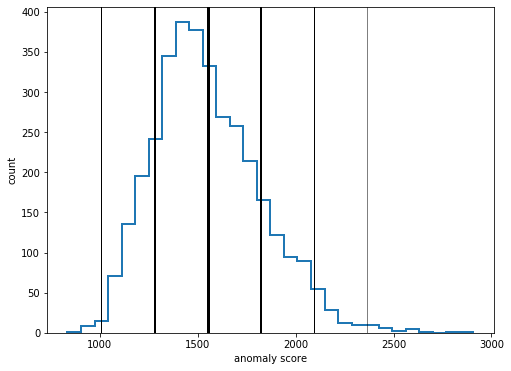

In [86]:
plt.figure(figsize=(8,6))
plt.hist(scores, bins=30, histtype='step', lw=2)
plt.axvline(mean, lw=3, c='k')
plt.axvline(mean+1*std, lw=2, c='k')
plt.axvline(mean-1*std, lw=2, c='k')
plt.axvline(mean+2*std, lw=1, c='k')
plt.axvline(mean-2*std, lw=1, c='k')
plt.axvline(mean+3*std, lw=0.5, c='k')
plt.xlabel("anomaly score")
plt.ylabel("count")

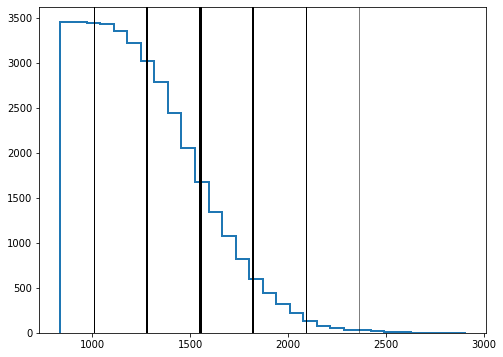

In [10]:
plt.figure(figsize=(8,6))
plt.hist(scores, bins=30, histtype='step', lw=2, cumulative=-1)
plt.axvline(mean, lw=3, c='k')
plt.axvline(mean+1*std, lw=2, c='k')
plt.axvline(mean-1*std, lw=2, c='k')
plt.axvline(mean+2*std, lw=1, c='k')
plt.axvline(mean-2*std, lw=1, c='k')
plt.axvline(mean+3*std, lw=0.5, c='k')

In [11]:
NBANDS = 3
def get_residuals(reals, recons):
    print("Getting residuals")
    reals = np.array(reals)
    reals = reals.reshape((-1,96,96,NBANDS))
    reals = luptonize(reals).astype('int')
    recons = np.array(recons)
    recons = recons.reshape((-1,96,96,NBANDS)).astype('int')
    resids = abs(reals-recons)
    return resids, reals, recons

In [12]:
def luptonize(x):
    rgb_q = 15
    rgb_stretch = 0.5
    rgb_min = 0
    if x.ndim==3:
        x = make_lupton_rgb(x[:,:,2], x[:,:,1], x[:,:,0],
                      Q=rgb_q, stretch=rgb_stretch, minimum=rgb_min)
    elif x.ndim==4:
        x = np.array([make_lupton_rgb(xi[:,:,2], xi[:,:,1], xi[:,:,0],
                      Q=rgb_q, stretch=rgb_stretch, minimum=rgb_min)
                      for xi in x])
    else:
        raise ValueError(f"Wrong number of dimensions! Gave {x.ndim}, need 3 or 4")
    return x

In [13]:
def embed(values, colorby, n_neighbors=5, min_dist=0.05, cmap='cool'):
    values = np.array(values)
    values = values.reshape((values.shape[0], -1))
    print(values.shape)
    print("Embedding")
    #values = np.array(values).flatten() 
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist)
    embedding = reducer.fit_transform(values)
    print("Plotting")
    plt.figure(figsize=(10,8))
    plt.scatter(embedding[:, 0], embedding[:, 1], marker='.', c=colorby, cmap=cmap, s=10,
                                                                vmin=min(colorby), vmax=mean+3*std)
    plt.xlabel('umap 1')
    plt.ylabel('umap 2')
    cbar = plt.colorbar(extend='max')
    cbar.set_label('anomaly score', rotation=270, labelpad=10)
    #plt.clim(0,4000)
    plt.gca().set_aspect('equal', 'datalim')
    return embedding

In [142]:
recon = res['reconstructed']
real = imarr['images']

In [15]:
resid = get_residuals(real, recon)[0]

Getting residuals


In [16]:
print(resid.shape)

(3452, 96, 96, 3)


(3452, 27648)
Embedding
Plotting


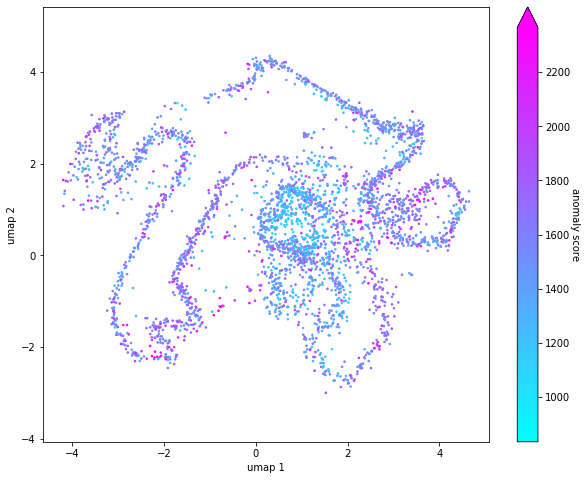

In [17]:
e = embed(resid, scores)

(3452, 27648)
Embedding
Plotting


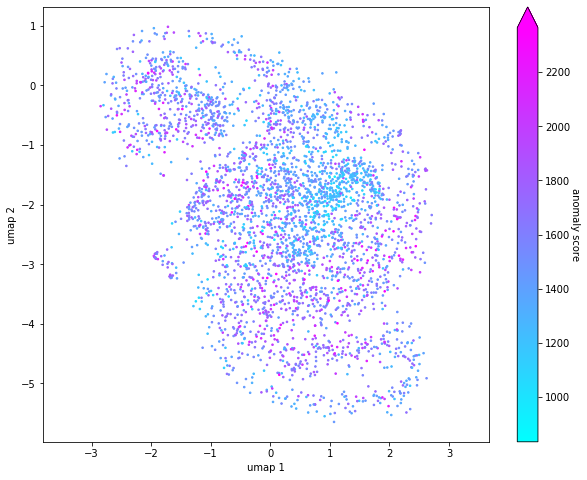

In [18]:
e = embed(resid, scores, n_neighbors=10)

(3452, 27648)
Embedding
Plotting


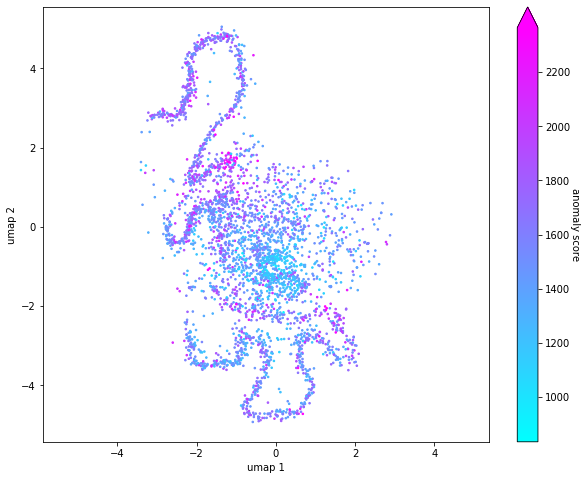

In [19]:
e = embed(resid, scores, min_dist=0.01)

[[-0.5007531  -1.6831093 ]
 [-0.8014653  -1.6579223 ]
 [ 0.11047911 -2.0295515 ]
 ...
 [ 0.24372083 -1.8260738 ]
 [ 0.41066438 -1.6005927 ]
 [ 0.35176364 -1.3116308 ]]
Making GMM
(3452, 2)
Predicting


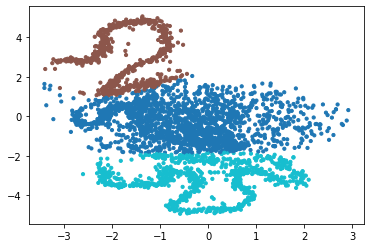

In [102]:
print(e)
n_components = 3
print("Making GMM")
valuesnoodle = np.array([e[:, 0], e[:, 1]]).T
print(valuesnoodle.shape)
gmmnoodle = GMM(n_components=n_components).fit(valuesnoodle)
print("Predicting")
gmmlabelsnoodle = gmmnoodle.predict(valuesnoodle)
#plt.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis')
plt.scatter(e[:, 0], e[:, 1], c=gmmlabelsnoodle, s=10, cmap='tab10')

-0.50378275 -0.32018006
0
1879
-1.7358148 3.004824
1
687
-0.12663306 -3.167098
2
886


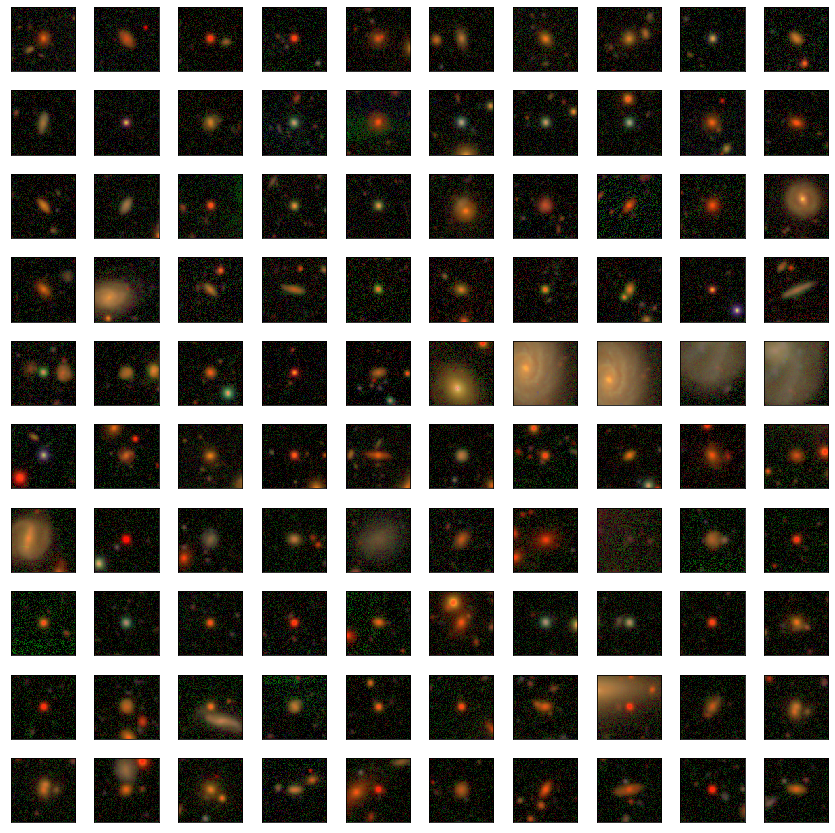

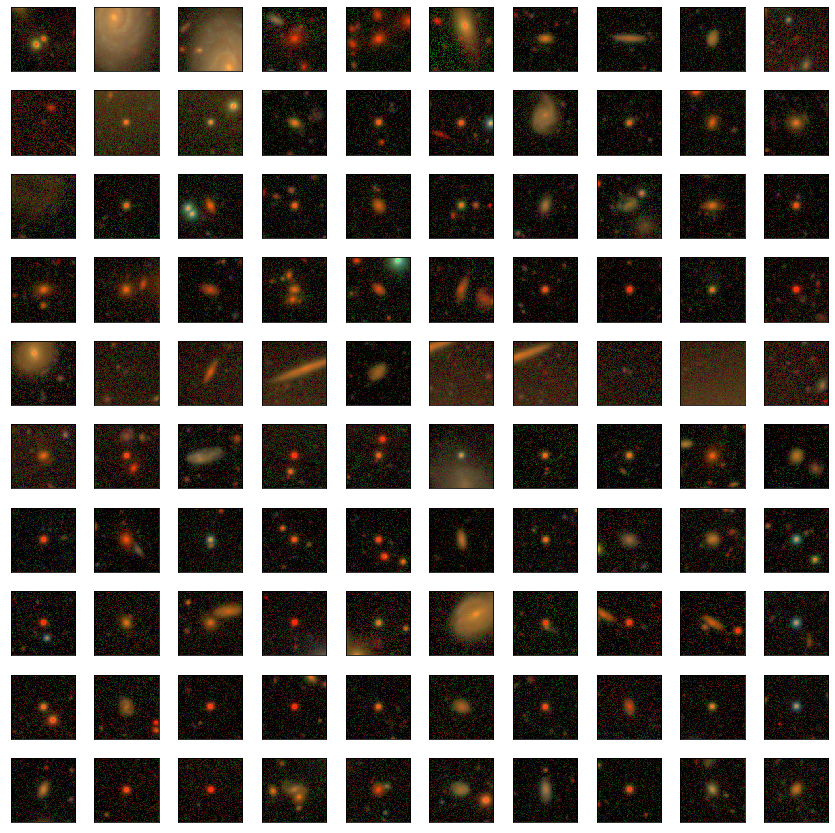

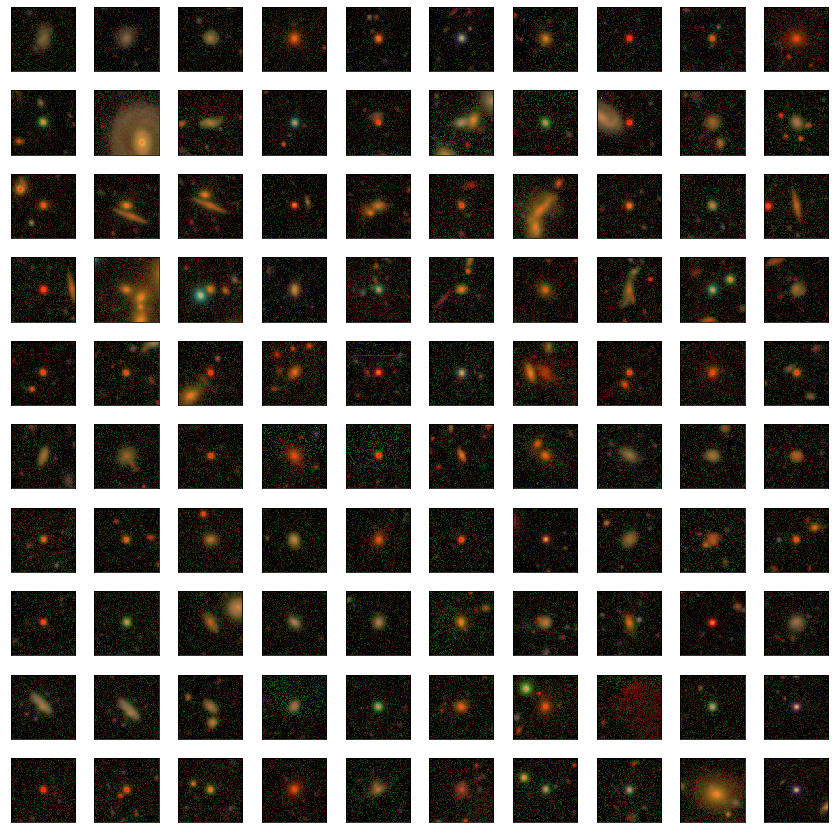

In [104]:
for nc in range(n_components):
    i_comp = np.array([i for i in range(len(gmmlabelsnoodle)) if gmmlabelsnoodle[i]==nc])
    print(np.mean(e[i_comp,0]), np.mean(e[i_comp,1]))
    print(nc)
    if len(i_comp)>=100:
        nrows = 10
        ncols = 10
    else:
        nrows = int(len(i_comp)/10)
        ncols = 10
        
    plot_sample(i_comp, nrows=nrows, ncols=ncols)

(3452, 27648)
Embedding
Plotting


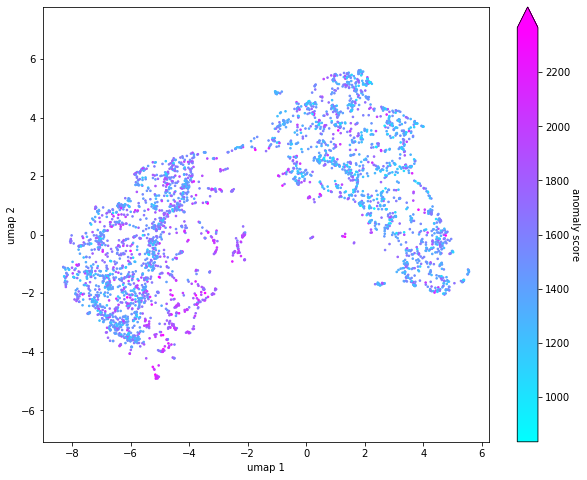

In [106]:
ereal = embed(real, scores, min_dist=0.05)

[[-0.5007531  -1.6831093 ]
 [-0.8014653  -1.6579223 ]
 [ 0.11047911 -2.0295515 ]
 ...
 [ 0.24372083 -1.8260738 ]
 [ 0.41066438 -1.6005927 ]
 [ 0.35176364 -1.3116308 ]]
Making GMM
(3452, 2)
Predicting


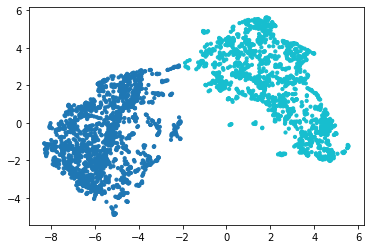

In [110]:
print(e)
n_components = 2
print("Making GMM")
valuesereal = np.array([ereal[:, 0], ereal[:, 1]]).T
print(valuesereal.shape)
gmmereal = GMM(n_components=n_components).fit(valuesereal)
print("Predicting")
gmmlabelsereal = gmmereal.predict(valuesereal)
#plt.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis')
plt.scatter(ereal[:, 0], ereal[:, 1], c=gmmlabelsereal, s=10, cmap='tab10')

-5.5032153 -0.80821073
0
1877
2.106217 2.1151655
1
1575


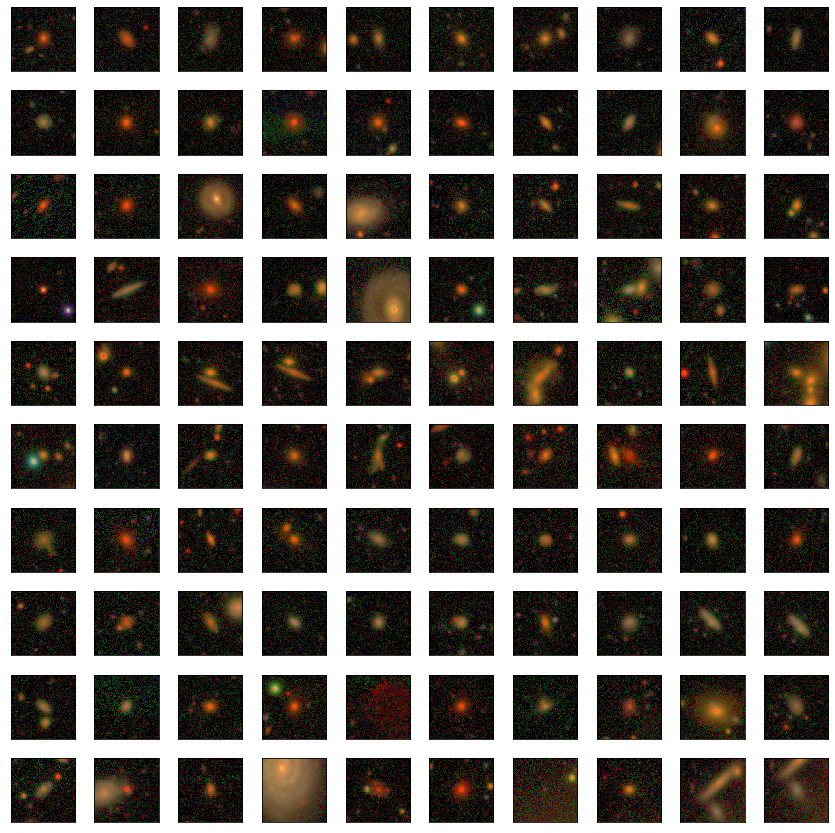

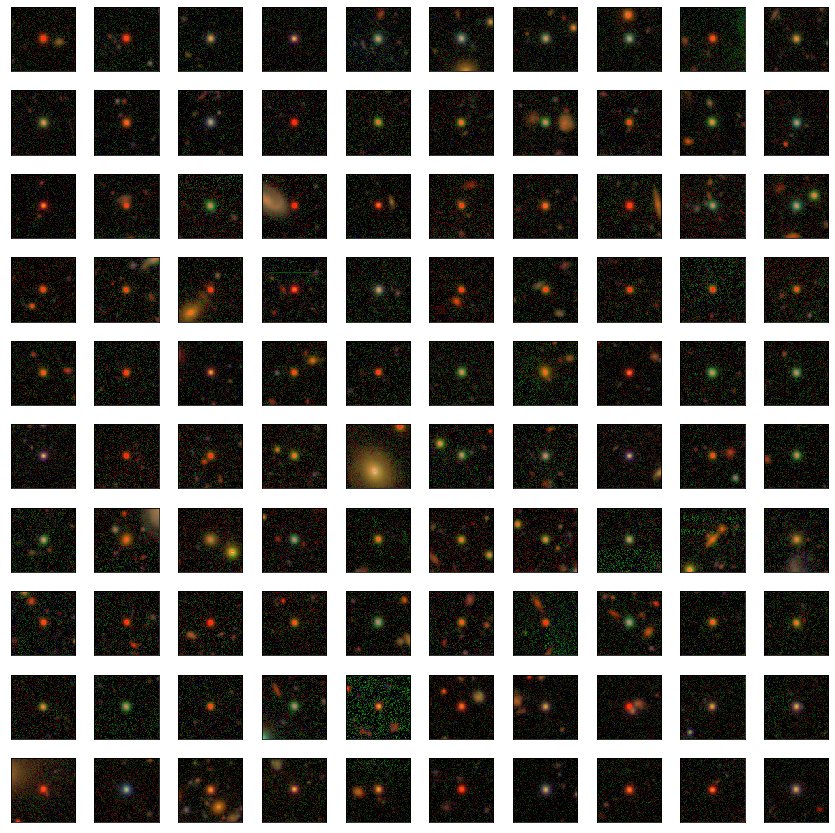

In [112]:
i_ereal = []
for nc in range(n_components):
    i_comp = np.array([i for i in range(len(gmmlabelsereal)) if gmmlabelsereal[i]==nc])
    print(np.mean(ereal[i_comp,0]), np.mean(ereal[i_comp,1]))
    print(nc)
    if len(i_comp)>=100:
        nrows = 10
        ncols = 10
    else:
        nrows = int(len(i_comp)/10)
        ncols = 10
    i_ereal.append(i_comp)    
    plot_sample(i_comp, nrows=nrows, ncols=ncols)

In [117]:
i_interesting = i_ereal[0]
i_interesting_1sig = [i for i in i_interesting if scores[i]>mean+1*std]
print(len(i_interesting_1sig))

409


(3452, 27648)
Embedding
Plotting


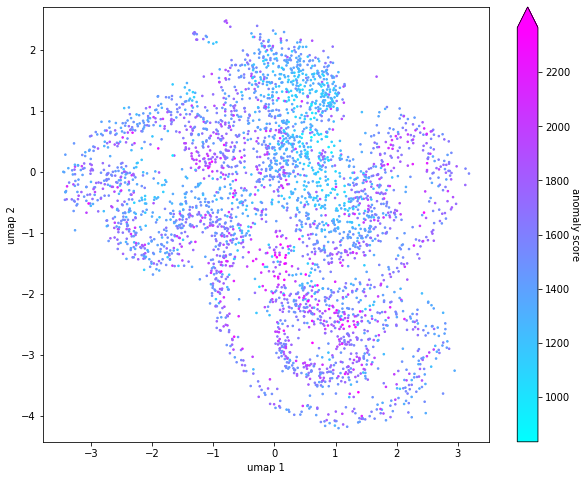

In [20]:
e1 = embed(resid, scores, n_neighbors=10, min_dist=0.1)

In [21]:
def make_mask(embt, ll, rr, bb, tt):
    emb = embt.T
    mask = ((ll<emb[0]) & (emb[0]<rr) & (bb<emb[1]) & (emb[1]<tt))
    return mask

In [22]:
m = make_mask(e1, -4, -2, 0.5, 2.5)

In [23]:
m.shape

(3452,)

In [24]:
ies = [i for i in range(len(m)) if m[i]]

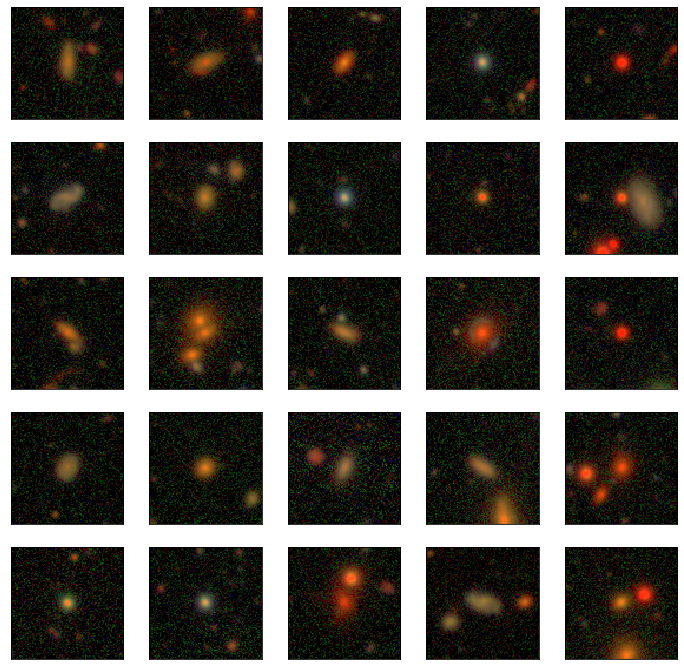

In [25]:
nrows = 5
ncols = 5
fig, axarr = plt.subplots(nrows, ncols, figsize=(12, 12))
ies_sample = np.random.choice(ies, size=nrows*ncols, replace=False)
cc = 0
for i in range(nrows):
    for j in range(ncols):
        ie = ies_sample[cc]
        im = real[ie]
        ax = axarr[i][j]
        ax.imshow(luptonize(im))
        ax.set_xticks([])
        ax.set_yticks([])
        cc += 1

In [26]:
ii_1sig = [i for i in range(len(idxs)) if scores[i]>mean+1*std]
len(ii_1sig)

552

## Residual image UMAP

(552, 27648)
Embedding


/Users/ksf/miniconda3/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


Plotting


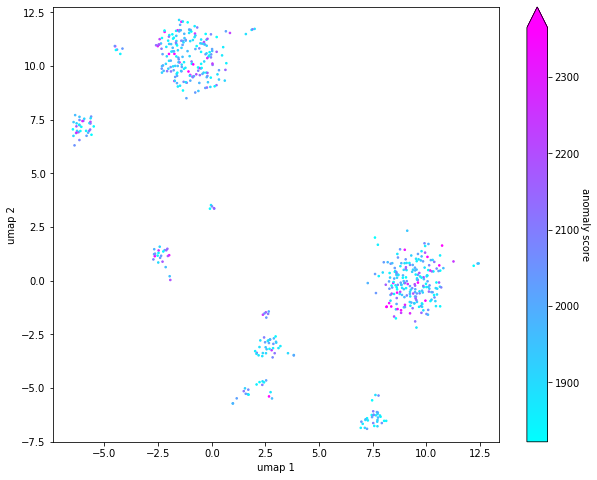

In [27]:
e1sig = embed(resid[ii_1sig], scores[ii_1sig], n_neighbors=2, min_dist=0.5)

[[ 7.2664742  -0.10732084]
 [ 9.941615    1.6201639 ]
 [ 9.106168    2.3318055 ]
 ...
 [10.071738   -1.5793852 ]
 [-2.2407389   9.780158  ]
 [10.639642   -1.1909173 ]]
Making GMM
(552, 2)
Predicting


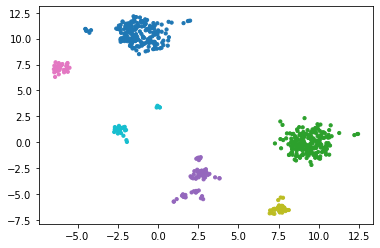

In [56]:
print(e1sig)
n_components = 6
print("Making GMM")
values = np.array([e1sig[:, 0], e1sig[:, 1]]).T
print(values.shape)
gmm = GMM(n_components=n_components).fit(values)
print("Predicting")
gmmlabels = gmm.predict(values)
#plt.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis')
plt.scatter(e1sig[:, 0], e1sig[:, 1], c=labels, s=10, cmap='tab10')

In [89]:
def plot_sample(ies, labels=None, nrows=2, ncols=8, show_resid=False, random=False, figsize=None):
    print(len(ies))
    nrows = nrows
    ncols = ncols
    if not figsize:
        figsize = (15,15)
    fig, axarr = plt.subplots(nrows, ncols, figsize=figsize)
    plt.subplots_adjust(hspace=.3, wspace=0)
    if len(ies)>nrows*ncols and random:
        ies_sample = np.random.choice(ies, size=nrows*ncols, replace=False)
    else:
        ies_sample = ies
    cc = 0
    for i in range(nrows):
        for j in range(ncols):
            ie = ies_sample[cc]
            if nrows==1:
                ax = axarr[j]
            else:
                ax = axarr[i][j]
            reali = luptonize(real[ie])
            if show_resid:
                reconi = recon[ie]
                residi = resid[ie]
                im = np.vstack((reali, reconi, residi))
            else:
                im = reali
            ax.imshow(im)
            ax.set_xticks([])
            ax.set_yticks([])
            if labels:
                ax.set_title(labels[cc])
            cc += 1

0
57
1
194
2
209
3
27
4
32
5
33


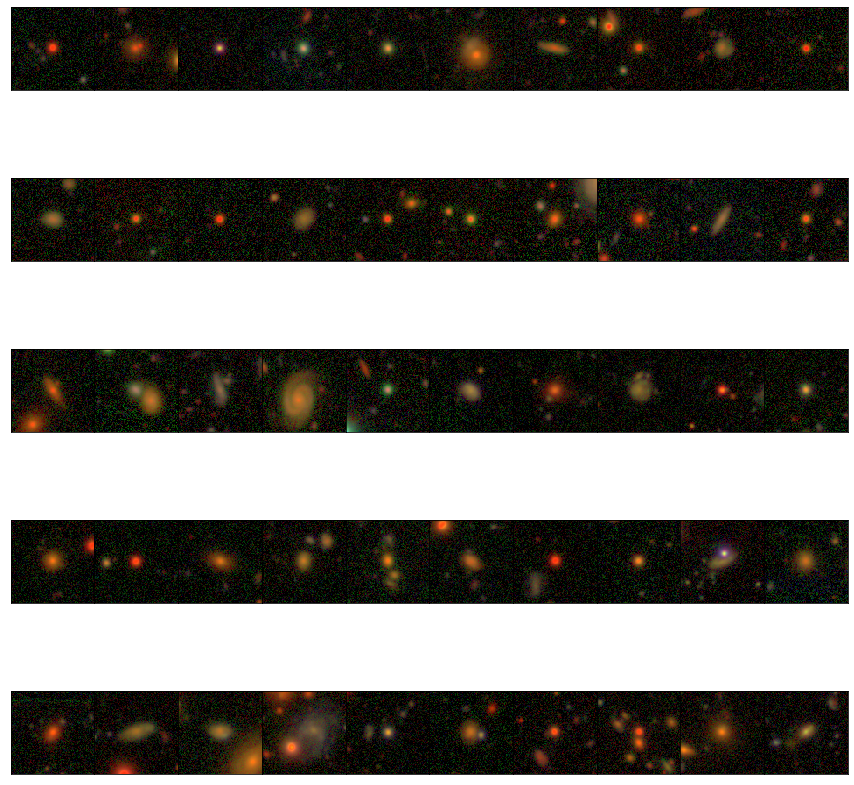

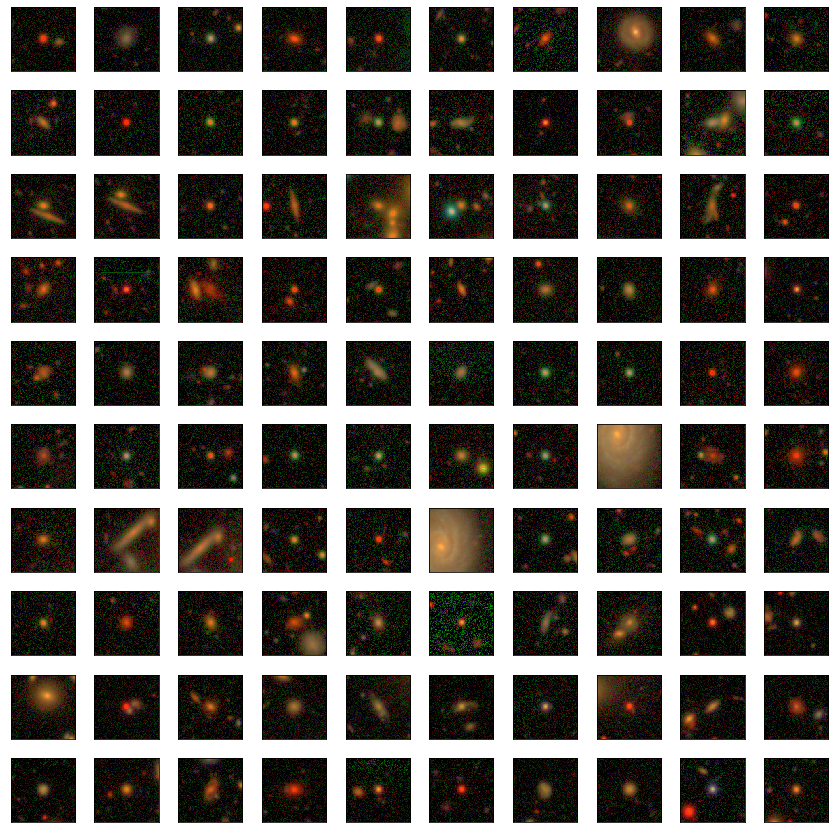

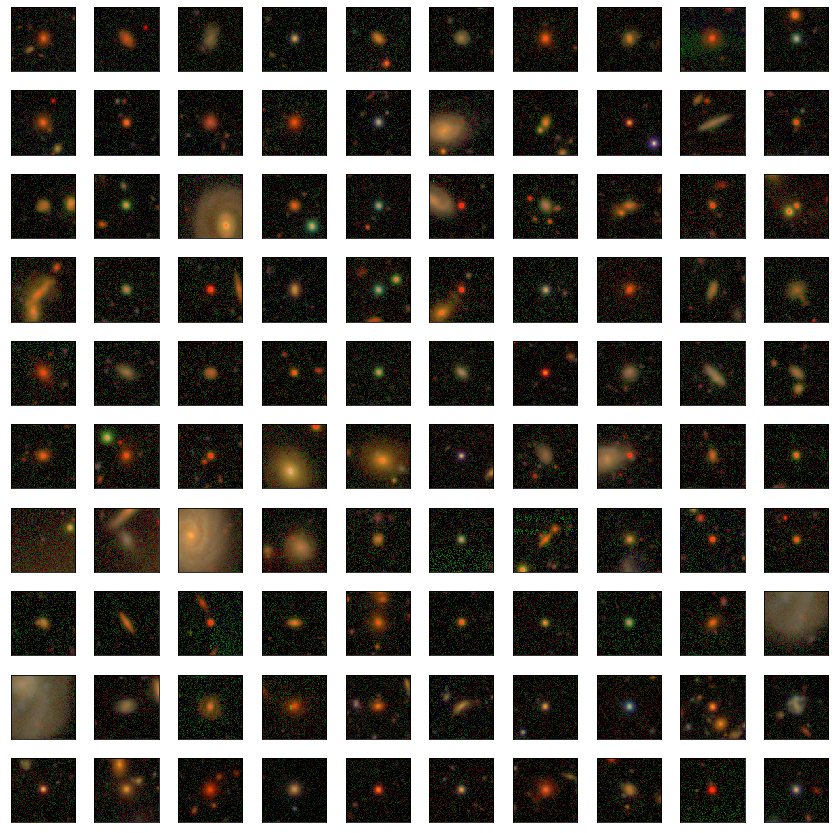

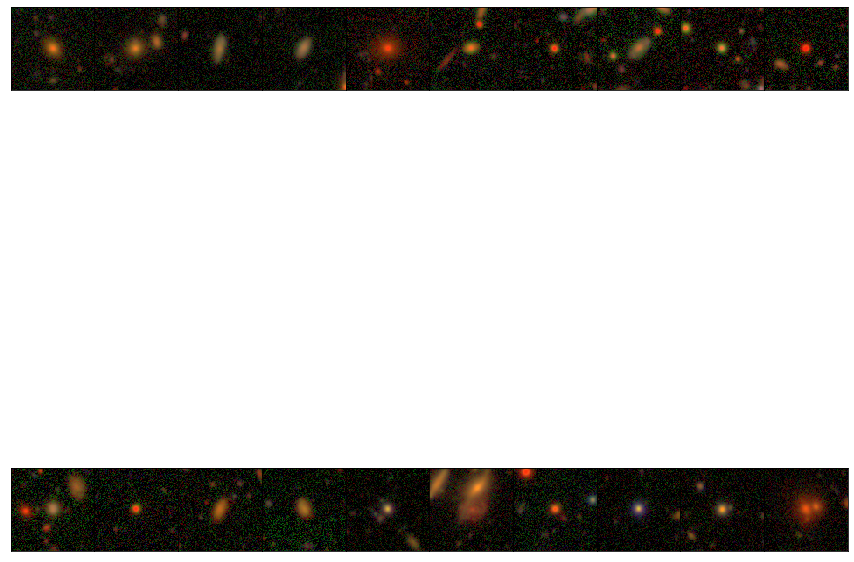

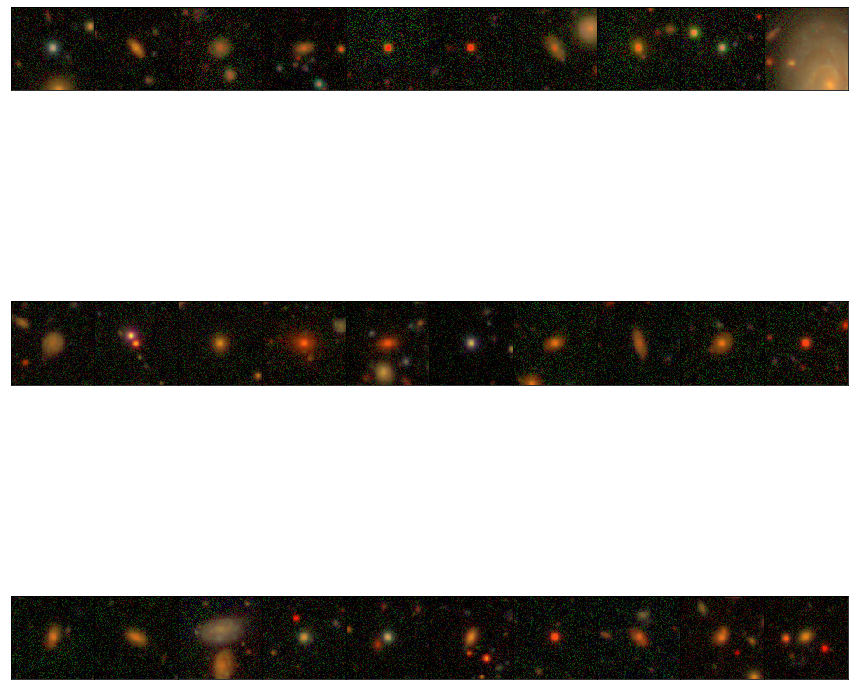

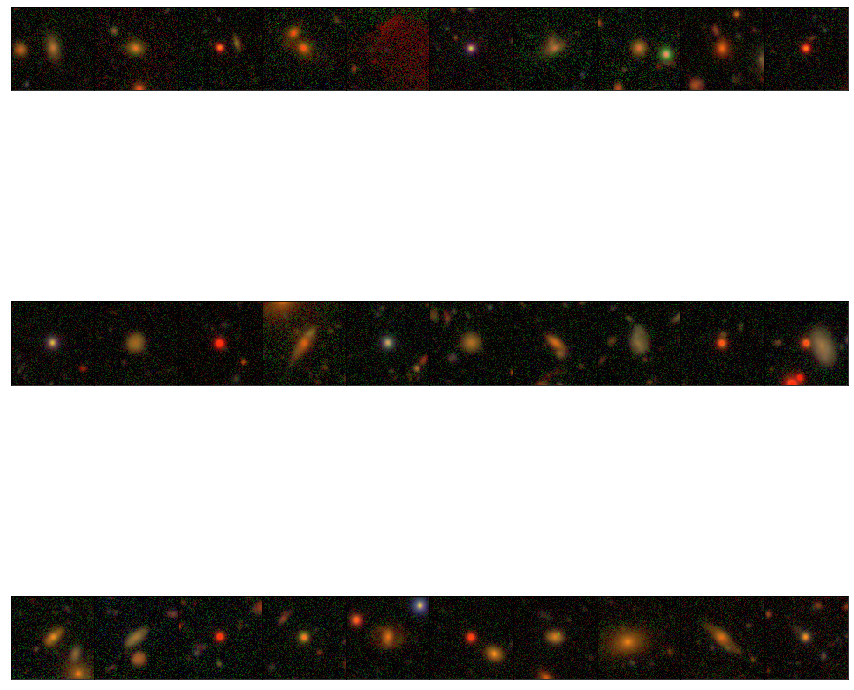

In [62]:
for nc in range(n_components):
    i_comp = np.array([i for i in range(len(gmmlabels)) if gmmlabels[i]==nc])
    print(nc)
    if len(i_comp)>=100:
        nrows = 10
        ncols = 10
    else:
        nrows = int(len(i_comp)/10)
        ncols = 10
        
    plot_sample(i_comp, nrows=nrows, ncols=ncols)

## Big cluster 1

162


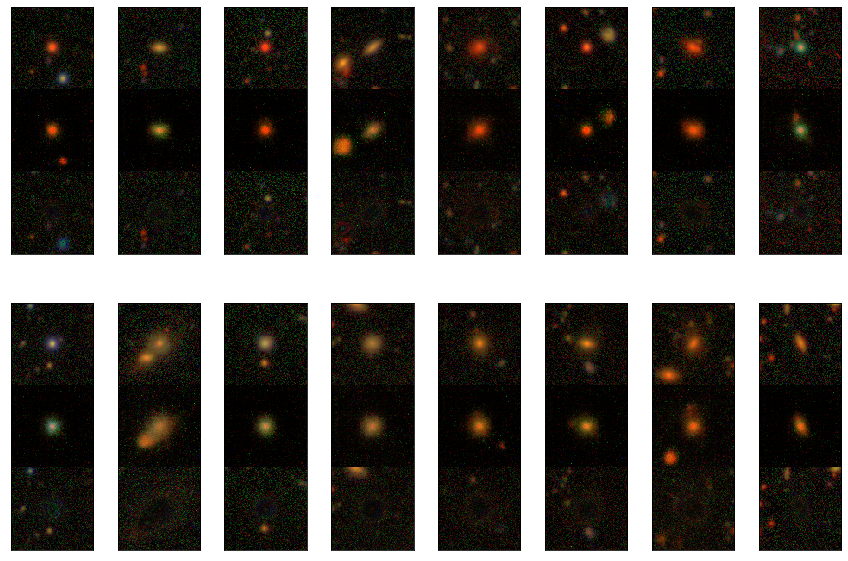

In [29]:
mask = make_mask(e1sig, -2, 3, 8, 12)
plot_sample([i for i in range(len(mask)) if mask[i]])

## Big cluster 2

158


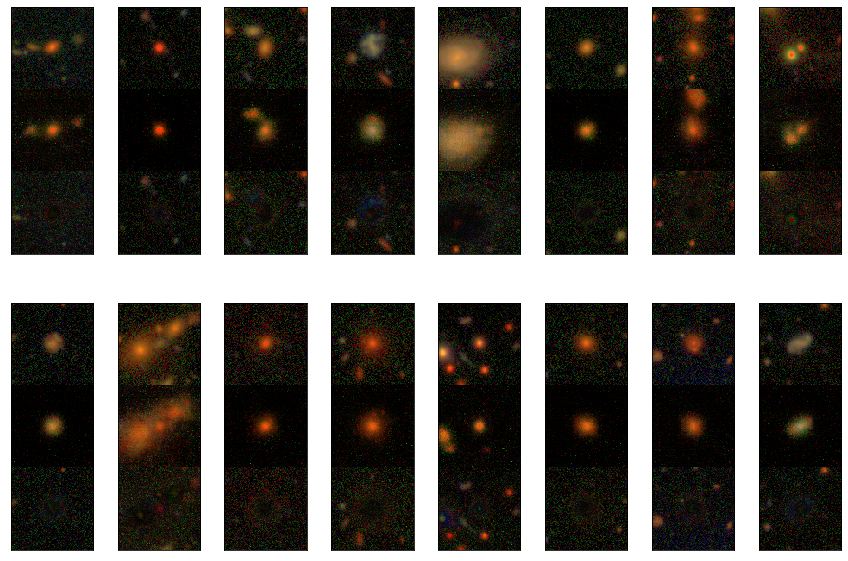

In [31]:
mask = make_mask(e1sig, 4, 10, -3, 2)
iis = [i for i in range(len(mask)) if mask[i]]
plot_sample(iis)

## Little cluster 1

24


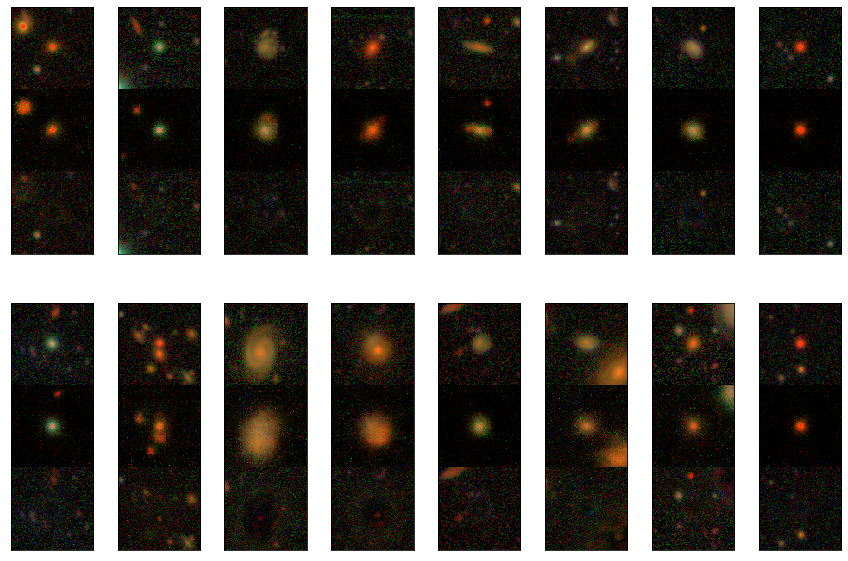

In [32]:
mask = make_mask(e1sig, -20, 2.5, -20, -2.5)
plot_sample([i for i in range(len(mask)) if mask[i]])

## Little cluster 2

In [33]:
m_ll = make_mask(e1sig, -20, -6, -20, 0)
ncols = len(np.nonzero(m_ll)[0])
print(ncols)
ies = [i for i in range(len(m_ll)) if m_ll[i]]
plot_sample(ies, ncols=len(ies), nrows=1)

0
0


<Figure size 1080x720 with 0 Axes>

## Little Cluster 3

In [ ]:
m_lr = make_mask(e1sig, 10, 20, -20, -6)
ncols = len(np.nonzero(m_lr)[0])
print(ncols)
ies = [i for i in range(len(m_lr)) if m_lr[i]]
plot_sample(ies)

## High anomaly score

25


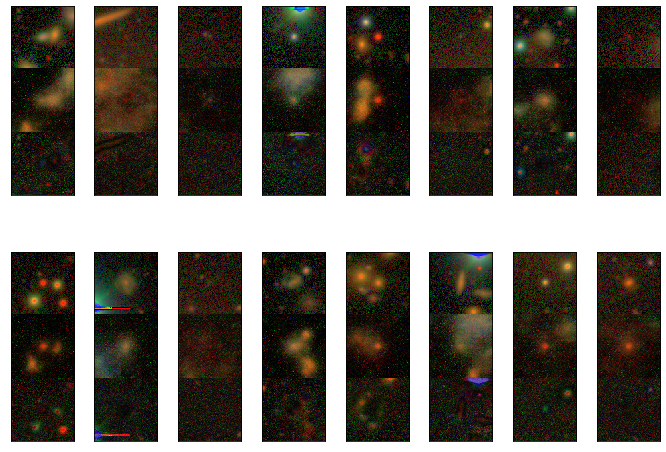

In [94]:
high = [i for i in range(len(idxs)) if scores[i]>mean+3*std]
plot_sample(high, show_resid=True, figsize=(12,8), random=True)

## Low anomaly score

148


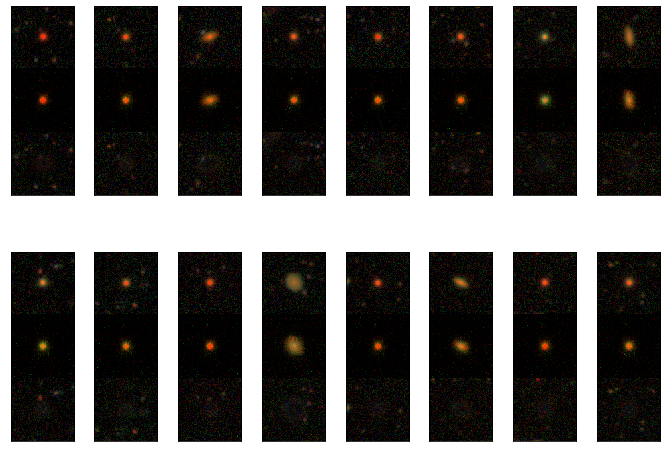

In [95]:
low = [i for i in range(len(idxs)) if scores[i]<mean-1.5*std]
plot_sample(low, show_resid=True, figsize=(12,8), random=True)

In [ ]:
imarr.close()
res.close()

## Real image UMAP 

(552, 27648)
Embedding
Plotting


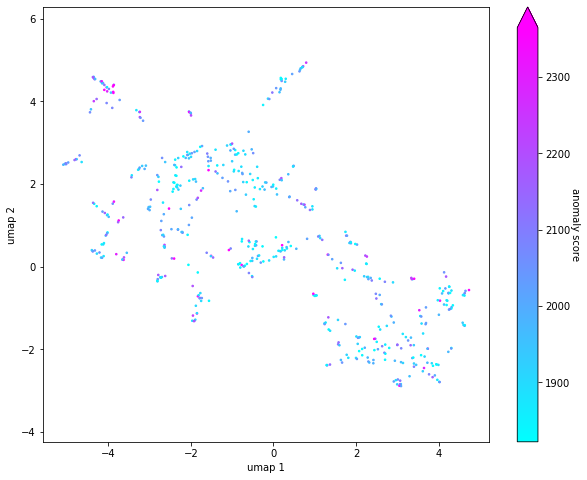

In [82]:
e1sigreal = embed(real[ii_1sig], scores[ii_1sig], n_neighbors=4, min_dist=0.005)

Making GMM
(552, 2)
Predicting


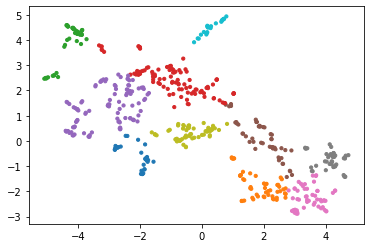

In [84]:
n_components = 10
print("Making GMM")
valuesreal = np.array([e1sigreal[:, 0], e1sigreal[:, 1]]).T
print(values.shape)
gmmreal = GMM(n_components=n_components).fit(valuesreal)
print("Predicting")
gmmlabelsreal = gmmreal.predict(valuesreal)
#plt.scatter(X[:, 0], X[:, 1], c=labels, s=40, cmap='viridis')
plt.scatter(e1sigreal[:, 0], e1sigreal[:, 1], c=gmmlabelsreal, s=10, cmap='tab10')

0
30
1
52
2
42
3
102
4
103
5
48
6
53
7
42
8
57
9
23


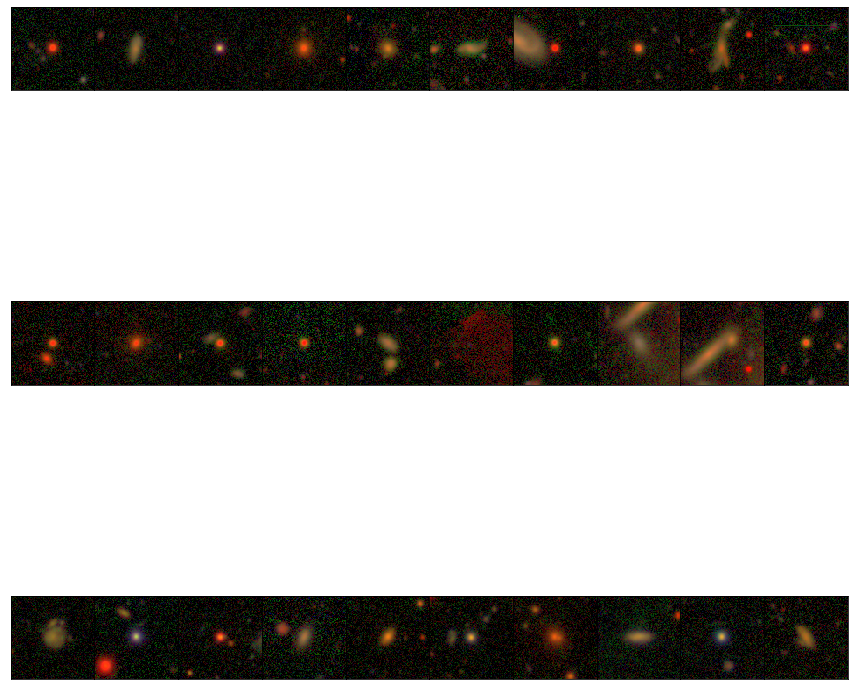

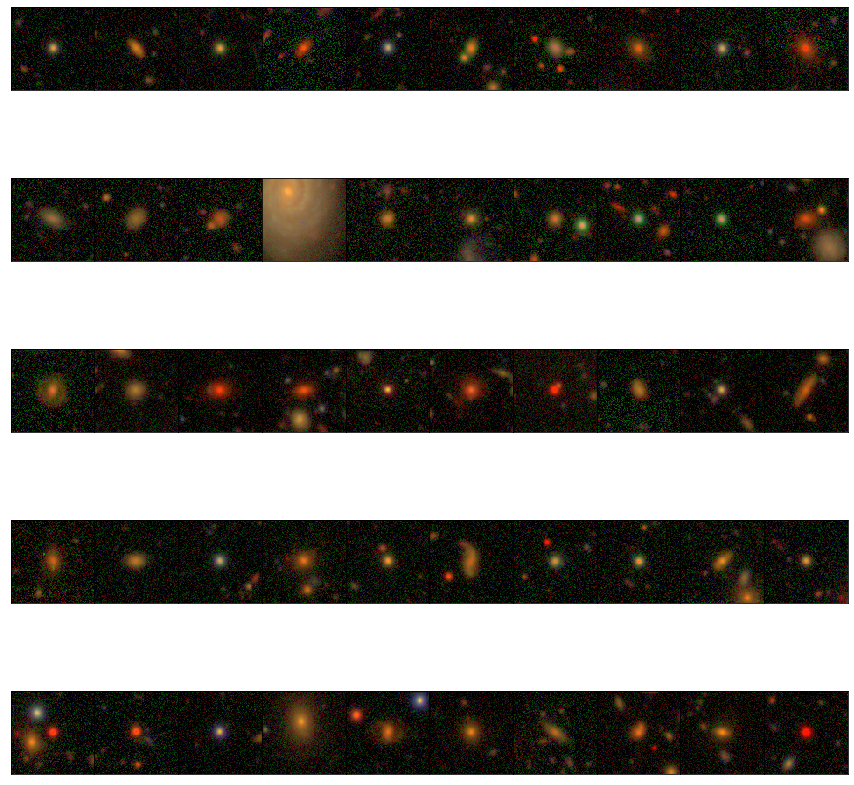

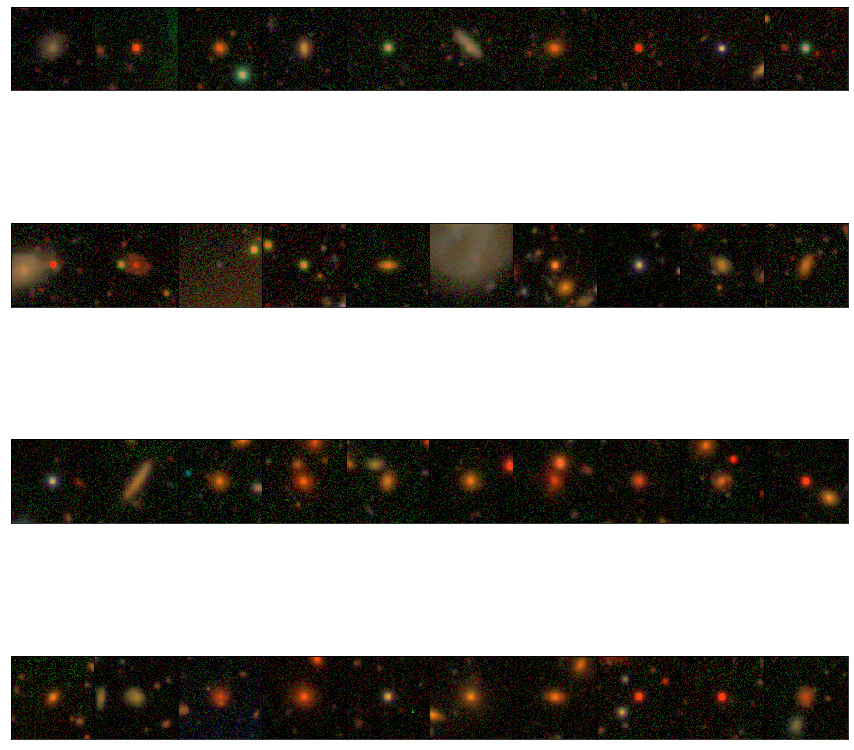

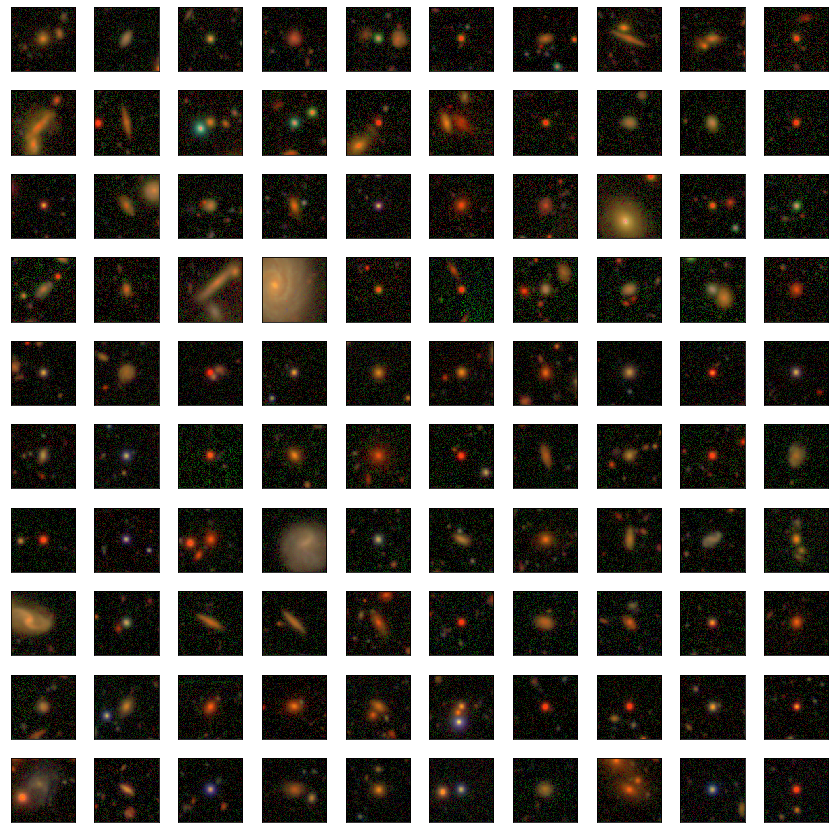

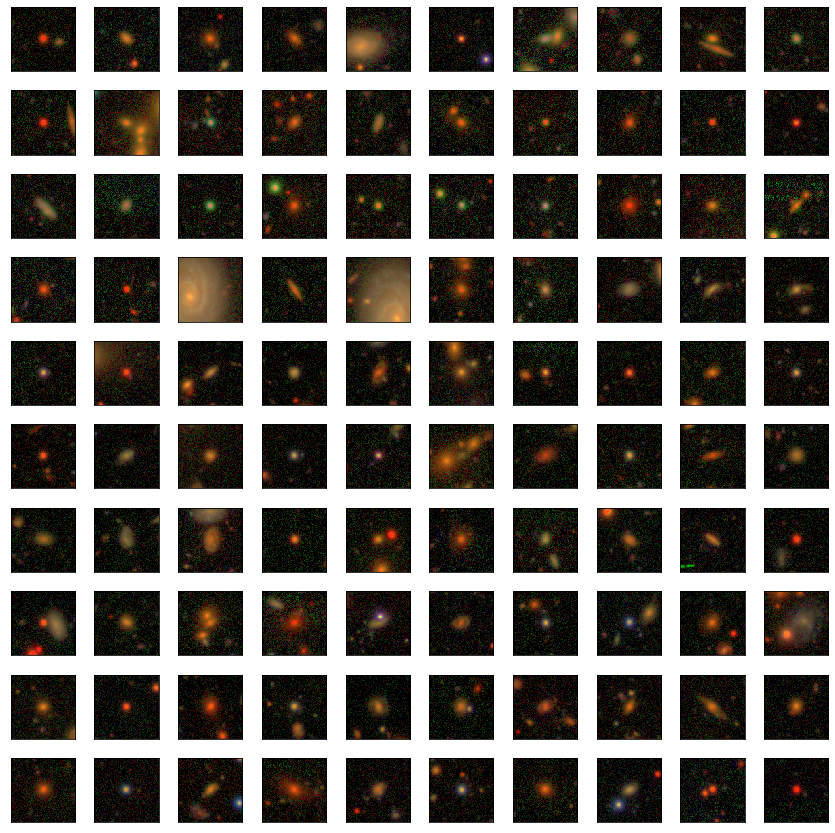

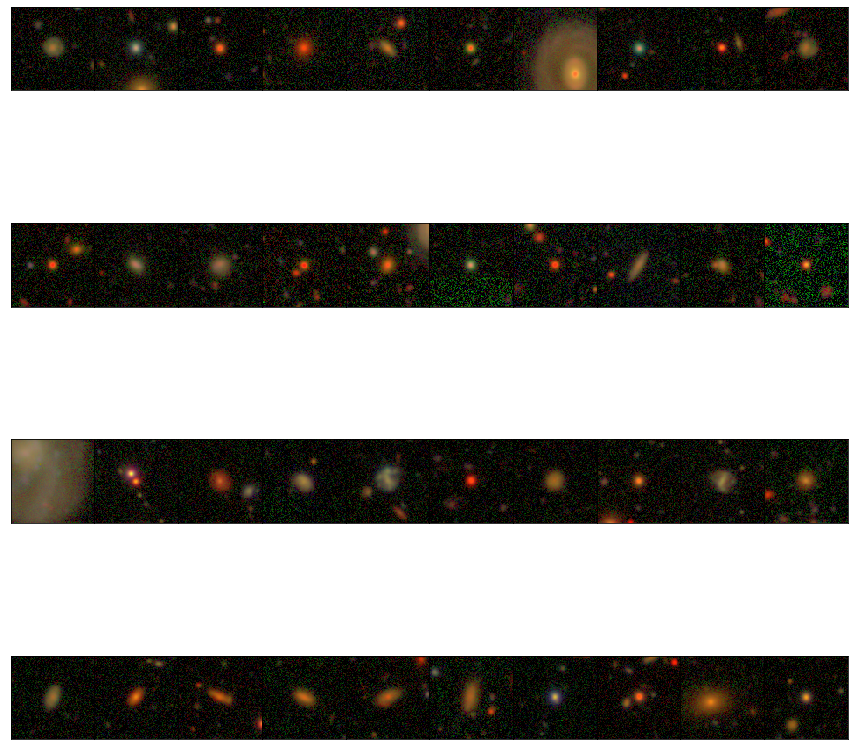

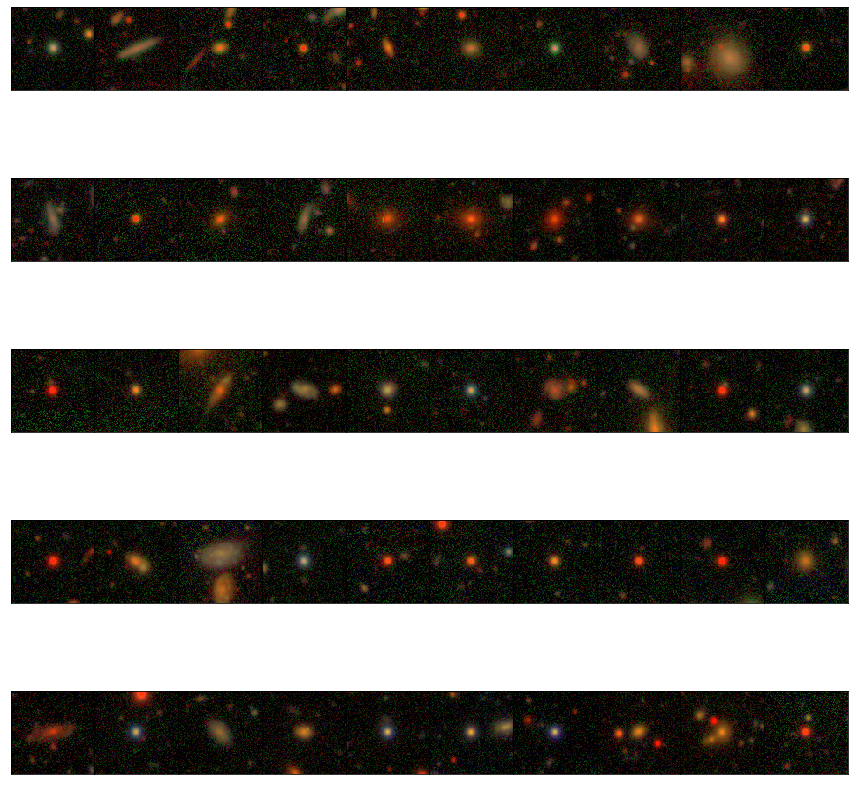

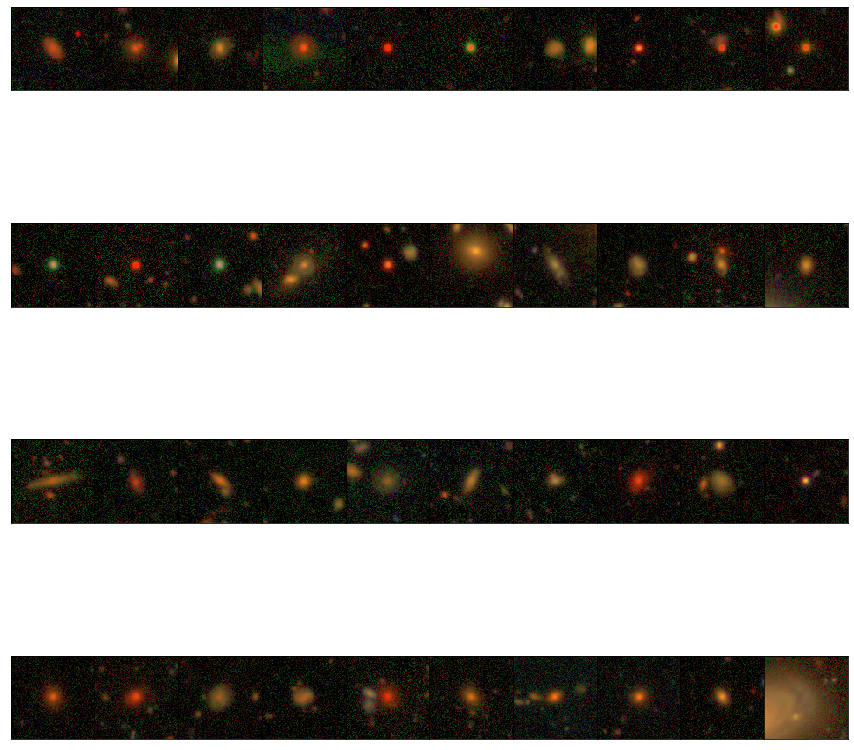

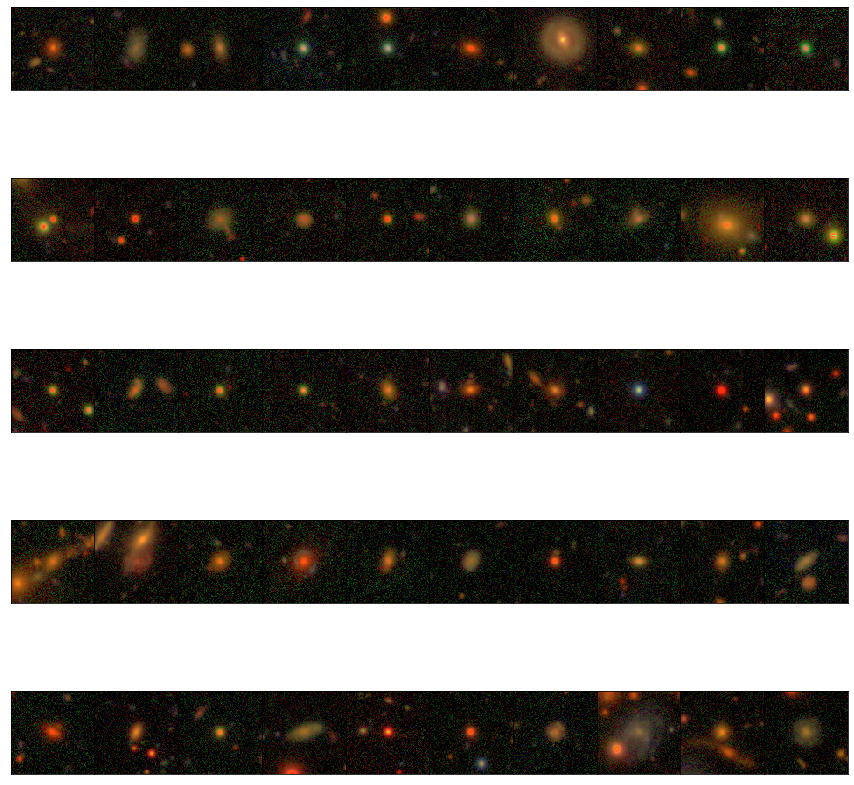

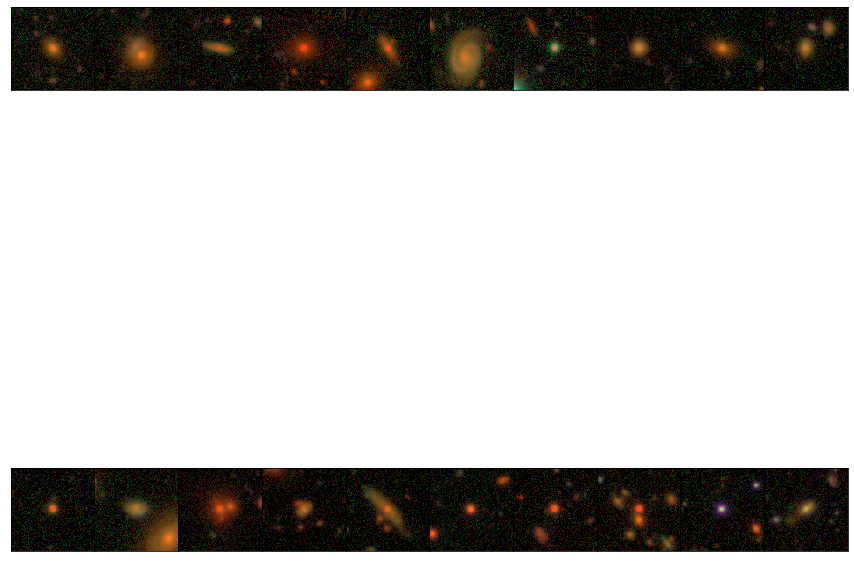

In [85]:
for nc in range(n_components):
    i_comp = np.array([i for i in range(len(gmmlabelsreal)) if gmmlabelsreal[i]==nc])
    print(nc)
    if len(i_comp)>=100:
        nrows = 10
        ncols = 10
    else:
        nrows = int(len(i_comp)/10)
        ncols = 10
        
    plot_sample(i_comp, nrows=nrows, ncols=ncols)

64
64


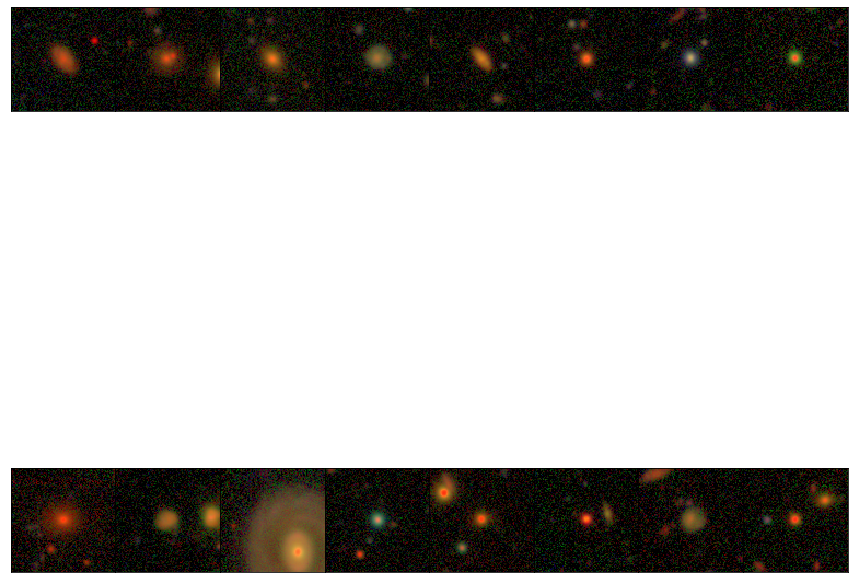

In [64]:
m = make_mask(e1sigreal, -10, -2, -4, 0)
ncols = len(np.nonzero(m)[0])
print(ncols)
ies = [i for i in range(len(m)) if m[i]]
plot_sample(ies)

13
13


IndexError: list index out of range

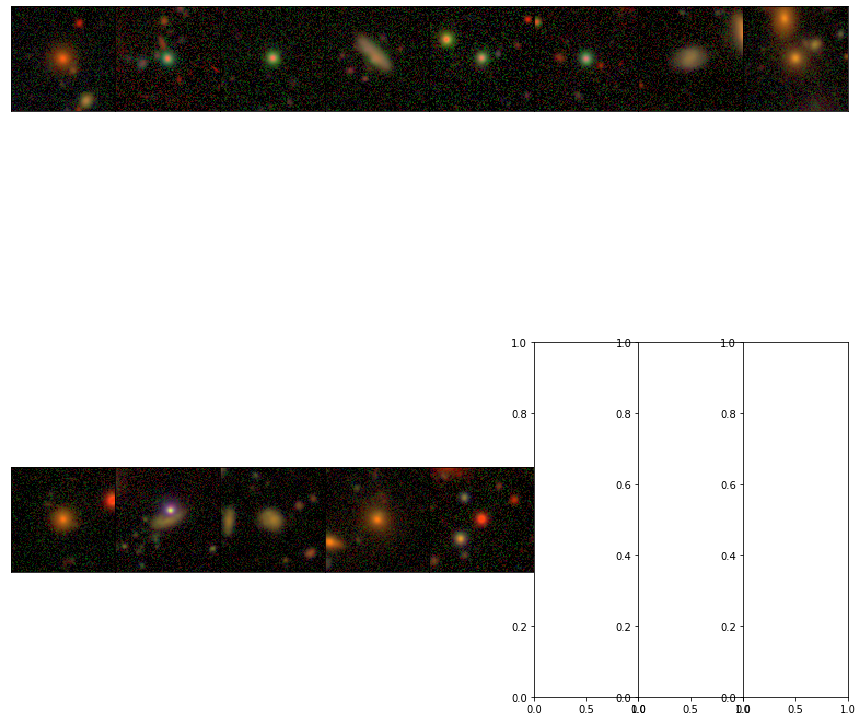

In [65]:
m = make_mask(e1sigreal, 5, 10, -10, 10)
ncols = len(np.nonzero(m)[0])
print(ncols)
ies = [i for i in range(len(m)) if m[i]]
plot_sample(ies)

In [ ]:
m = make_mask(e1sigreal, -10, -1, 0, 10)
ncols = len(np.nonzero(m)[0])
print(ncols)
ies = [i for i in range(len(m)) if m[i]]
plot_sample(ies)

11
11


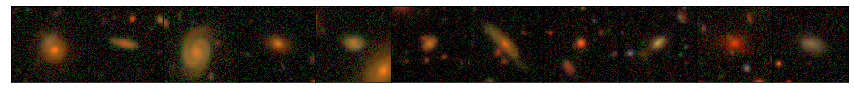

In [66]:
m = make_mask(e1sigreal, -10, 10, -10, -5)
ncols = len(np.nonzero(m)[0])
print(ncols)
ies = [i for i in range(len(m)) if m[i]]
plot_sample(ies, ncols=ncols, nrows=1)

In [222]:
#ii_test = [35,80]
for idx in ii_1sig:
    im = real[idx]
    scoreint = int(scores[idx])
    #print(cat['object_id'][idx])
    #print(int(object_ids[idx]))
    #print(cat.loc[cat['object_id']==int(object_ids[idx])])
    print(idx)
    print(idxs[idx])
    print(cat.iloc[idx])
    print(cat['object_id'][idxs[idx]])


    break
    save_fn = f"../thumbnails/cosmos/cosmos_idxcosmos{idx}_objectid{cat['object_id'][idx]}_score{scoreint}.png"
    #ims = ims.transpose(3, 1, 2)
    #im = luptonize(im)
    #imwrite(save_fn, im)

18
112.0
Unnamed: 0                                 930489
Unnamed: 0.1                               930489
Unnamed: 0.1.1                             930489
Unnamed: 0.1.1.1                           959446
object_id                       43153640956908338
                                      ...        
r_cmodel_ellipse_22                     0.0354077
r_cmodel_ellipse_12                     0.0148331
i_cmodel_ellipse_radius                   0.19675
i_cmodel_ellipse_ellipticity             0.722154
i_cmodel_ellipse_theta                    -64.489
Name: 18, Length: 181, dtype: object
43153653841811204


### Just images, no resids

In [ ]:
m = make_mask(e1sigreal, -10, -2, -4, 0)
ncols = len(np.nonzero(m)[0])
print(ncols)
ies = [i for i in range(len(m)) if m[i]]
plot_sample(ies)

In [122]:
import plotly
import plotly.express as px

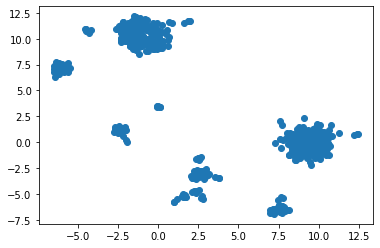

In [123]:
def embed(values, colorby, n_neighbors=5, min_dist=0.05, cmap='cool'):
    values = np.array(values)
    values = values.reshape((values.shape[0], -1))
    print(values.shape)
    print("Embedding")
    #values = np.array(values).flatten() 
    reducer = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist)
    embedding = reducer.fit_transform(values)
    print("Plotting")
    plt.figure(figsize=(10,8))
    plt.scatter(embedding[:, 0], embedding[:, 1], marker='.', c=colorby, cmap=cmap, s=10,
                                                                vmin=min(colorby), vmax=mean+3*std)
    plt.xlabel('umap 1')
    plt.ylabel('umap 2')
    cbar = plt.colorbar(extend='max')
    cbar.set_label('anomaly score', rotation=270, labelpad=10)
    #plt.clim(0,4000)
    plt.gca().set_aspect('equal', 'datalim')
    return embedding

x = e1sig[:,0]
y = e1sig[:,1]
plt.scatter(x,y)

In [137]:
print(x.shape)
print(real[ii_1sig].shape)
#df = pd.DataFrame(np.array([x,y,real[ii_1sig]]).T, columns=['u1','u2','real'])
#px.scatter(df, x='u1', y='u2')

(552,)
(552, 96, 96, 3)


ValueError: could not broadcast input array from shape (552,96,96,3) into shape (552)

In [143]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox


# create the annotations box
imint = 
im = OffsetImage(real[:,:,:,0], zoom=5)
xybox=(50., 50.)
ab = AnnotationBbox(im, (0,0), xybox=xybox, xycoords='data',
        boxcoords="offset points",  pad=0.3,  arrowprops=dict(arrowstyle="->"))
# add it to the axes and make it invisible
ax.add_artist(ab)
ab.set_visible(False)

def hover(event):
    # if the mouse is over the scatter points
    if line.contains(event)[0]:
        # find out the index within the array from the event
        ind, = line.contains(event)[1]["ind"]
        # get the figure size
        w,h = fig.get_size_inches()*fig.dpi
        ws = (event.x > w/2.)*-1 + (event.x <= w/2.) 
        hs = (event.y > h/2.)*-1 + (event.y <= h/2.)
        # if event occurs in the top or right quadrant of the figure,
        # change the annotation box position relative to mouse.
        ab.xybox = (xybox[0]*ws, xybox[1]*hs)
        # make annotation box visible
        ab.set_visible(True)
        # place it at the position of the hovered scatter point
        ab.xy =(x[ind], y[ind])
        # set the image corresponding to that point
        im.set_data(arr[ind,:,:])
    else:
        #if the mouse is not over a scatter point
        ab.set_visible(False)
    fig.canvas.draw_idle()

# add callback for mouse moves
fig.canvas.mpl_connect('motion_notify_event', hover)           
plt.show()


TypeError: Invalid shape (3452, 96, 96) for image data

In [145]:
imdir = '/Users/ksf/code/kavli/cosmos_targets/cosmos_1sigma_interesting/cosmos_bluecore'
idxs_blue = []
for fn in os.listdir(imdir):
    prestr = 'idxcosmos'
    idxstr = fn.split('_')[1][len(prestr):]
    idxs_blue.append(int(idxstr))
print(idxs_blue)

[1088, 1052, 2089, 2528, 1820, 1894, 1737, 80, 2633, 2904, 2725, 261, 2867, 2453, 616, 1837, 1687, 2278, 3272, 2083, 3059, 1838, 1832, 2423, 1833, 2797, 208, 1102, 1380, 2890, 192, 2635, 1635, 1843, 2095, 1405, 2084, 2244, 2306, 2340, 2100, 84, 19, 2035, 566, 1893, 78, 1054, 3075, 1461, 2018, 2128, 1726, 1661, 1769, 1449, 2106, 2869, 2975]


In [206]:
cat.iloc[1088]

Unnamed: 0                                 935092
Unnamed: 0.1                               935092
Unnamed: 0.1.1                             935092
Unnamed: 0.1.1.1                           964169
object_id                       43158455615257543
                                      ...        
r_cmodel_ellipse_22                   3.80852e-05
r_cmodel_ellipse_12                  -2.62925e-07
i_cmodel_ellipse_radius                 0.0134238
i_cmodel_ellipse_ellipticity             0.590239
i_cmodel_ellipse_theta                   -80.7496
Name: 1088, Length: 181, dtype: object

In [205]:
rab, decb, objb = [], [], []
header = 'object_id, ra, dec, cosmos_hsc_id'
for i in range(len(idxs_blue)):
    idxb = idxs_blue[i]
    row = cat.iloc[idxb]
    objb.append(row['object_id'])
    rab.append(row['ra_x'])
    decb.append(row['dec_x'])
    print(int(object_ids[idxb]))
    print(row['object_id'])


    
data_blue = np.array([objb, rab, decb, idxs_blue])
np.savetxt('cosmos_bluecore_bad.csv', data_blue.T, delimiter=',', fmt=['%d', '%.14f', '%.16f', '%d'], header=header)

43690211221176320
43158455615257543
43690206926209024
43158455615251989
43690614948102144
43158739083087683
43694622152589312
43158867932115274
43690473214181376
43158614529040256
43690477509148672
43158726198167582
43690361545031680
43158605939112568
43360619725848576
43153645251884997
43694738116706304
43158876522029211
43694755296575488
43158996781134001
43694742411673600
43158880817014078
43365017772359680
43158172147408017
43690490394050560
43158996781126210
43694613562654720
43158863637145845
43370098718670848
43158322471263796
43690473214181376
43158721903220108
43690361545031680
43158605939083269
43690632127971328
43158747673025302
43694888440561664
43159026845898657
43690610653134848
43158734788135811
43694875555659776
43159009666030711
43690473214181376
43158721903220413
43690473214181376
43158721903219613
43690486099083264
43158863637140417
43690473214181376
43158721903219618
43694746706640896
43158885111979408
43361444359569408
43153662431749474
43690215516143616
4315845991

In [208]:
rab, decb, objb = [], [], []
header = 'object_id, ra, dec, cosmos_hsc_id, image_cat_id'
ids_cat = []
for i in range(len(idxs_blue)):
    idxb = idxs_blue[i]
    idx_cat = int(idxs[idxb])
    row = cat.iloc[idx_cat]
    objb.append(row['object_id'])
    rab.append(row['ra_x'])
    decb.append(row['dec_x'])
    ids_cat.append(idx_cat)
    #print(int(object_ids[idx_cat]))
    #print(row['object_id'])
    
data_blue = np.array([objb, rab, decb, ids_cat, idxs_blue])
np.savetxt('cosmos_bluecore.csv', data_blue.T, delimiter=',', fmt=['%d', '%.14f', '%.16f', '%d', '%d'], header=header)

In [218]:
rab, decb, objb = [], [], []
header = 'object_id, ra, dec, cosmos_hsc_id, image_cat_id'
ids_cat = []
for i in range(len(idxs_blue)):
    idxb = idxs_blue[i]
    idx_cat = int(idxs[idxb])
    print(idxb)
    print(int(object_ids[idxb]))
    row = cat.loc[cat['object_id'] == int(object_ids[idxb])]
    print(row)
    objb.append(row['object_id'])
    rab.append(row['ra_x'])
    decb.append(row['dec_x'])
    ids_cat.append(idx_cat)
    #print(int(object_ids[idx_cat]))
    #print(row['object_id'])
    
data_blue = np.array([objb, rab, decb, ids_cat, idxs_blue])
np.savetxt('cosmos_bluecore2.csv', data_blue.T, delimiter=',', fmt=['%d', '%.14f', '%.16f', '%d', '%d'], header=header)

1088
43690211221176320
Empty DataFrame
Columns: [Unnamed: 0, Unnamed: 0.1, Unnamed: 0.1.1, Unnamed: 0.1.1.1, object_id, ra_x, dec_x, tract_x, patch_x, parent_id_x, a_g, a_r, a_i, a_z, a_y, g_cmodel_mag, r_cmodel_mag, i_cmodel_mag, z_cmodel_mag, y_cmodel_mag, g_cmodel_magsigma, r_cmodel_magsigma, i_cmodel_magsigma, z_cmodel_magsigma, y_cmodel_magsigma, g_cmodel_fracdev, r_cmodel_fracdev, i_cmodel_fracdev, z_cmodel_fracdev, y_cmodel_fracdev, g_cmodel_flag, r_cmodel_flag, i_cmodel_flag, z_cmodel_flag, y_cmodel_flag, g_psfflux_mag, r_psfflux_mag, i_psfflux_mag, z_psfflux_mag, y_psfflux_mag, g_psfflux_magsigma, r_psfflux_magsigma, i_psfflux_magsigma, z_psfflux_magsigma, y_psfflux_magsigma, g_psfflux_flag, r_psfflux_flag, i_psfflux_flag, z_psfflux_flag, y_psfflux_flag, g_pixelflags_edge, r_pixelflags_edge, i_pixelflags_edge, z_pixelflags_edge, y_pixelflags_edge, g_pixelflags_interpolated, r_pixelflags_interpolated, i_pixelflags_interpolated, z_pixelflags_interpolated, y_pixelflags_interpolat

TypeError: Mismatch between array dtype ('object') and format specifier ('%d,%.14f,%.16f,%d,%d')

In [172]:
from unagi import config
from unagi import hsc
from unagi.task import hsc_tricolor

In [173]:
pdr2_wide = hsc.Hsc(dr='pdr2', rerun='pdr2_wide', config_file='../cred.dat')

# Get table list from /Users/ksf/miniconda3/lib/python3.7/site-packages/unagi-0.1.0-py3.7.egg/unagi/data/pdr2_wide/pdr2_wide_tables.fits


In [199]:
filters = ['g','r','i']
ang_size_h = 10*u.arcsec
ang_size_w = 10*u.arcsec

cutouts = []
ncuts = 4
for i in range(ncuts):
    
    print(i)
    
    coord = SkyCoord(rab[i], decb[i], frame='icrs', unit='deg')
    
    s_ang = [ang_size_h, ang_size_w]
    cutout_rgb, cutout_wcs = hsc_tricolor(
        coord, cutout_size=s_ang, filters=filters, verbose=False, 
        save_rgb=False, save_img=False, use_saved=False, archive=pdr2_wide)
    print(cutout_rgb.data.shape)
    cutouts.append(cutout_rgb)

0
(120, 120, 3)
1
(120, 120, 3)
2
(120, 120, 3)
3
(121, 120, 3)


1088
1176
1052
1143
2089
2177
2528
2572


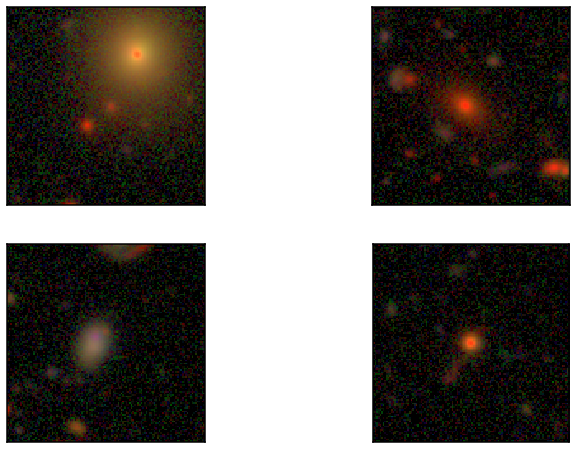

In [201]:
nrows = 2
ncols = 2
panelsize = 2
fig, axarr = plt.subplots(nrows,ncols, figsize=(12,8))#figsize=(panelsize*nrows,panelsize*ncols))
#plt.subplots_adjust(hspace=-0.5, wspace=0.2)
#fig.suptitle('i-band: 21.0-21.5')
cc = 0
bandidx = 2
for i in range(nrows):
    for j in range(ncols):
        img = cutouts[cc]
        axarr[i][j].imshow(img, origin='lower')
        axarr[i][j].set_xticks([])
        axarr[i][j].set_yticks([])
        print(idxs_blue[cc])
        print(ids_cat[cc])
        #axarr[i][j].set_title(str(idxs_blue[cc]))
        #axarr[i][j].set_title(r"$R_e$: {:.3f}, {}".format(sample[Re][cc], extlabel), fontsize=14)
        cc += 1
plt.show()

1088
1176.0
1052
1143.0
2089
2177.0
2528
2572.0


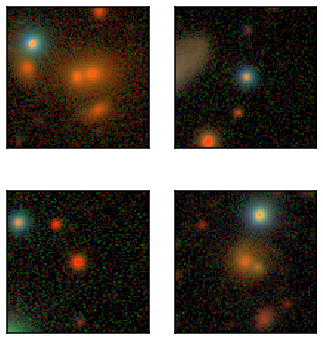

In [189]:
ies_sample = idxs_blue[:4]
show_resid = False
labels = None
nrows = 2
ncols = 2
figsize = (6,6)
fig, axarr = plt.subplots(nrows, ncols, figsize=figsize)
plt.subplots_adjust(hspace=.3, wspace=0)
cc = 0
for i in range(nrows):
    for j in range(ncols):
        ie = ies_sample[cc]
        print(ie)
        print(idxs[ie])
        if nrows==1:
            ax = axarr[j]
        else:
            ax = axarr[i][j]
        reali = luptonize(real[ie])
        if show_resid:
            reconi = recon[ie]
            residi = resid[ie]
            im = np.vstack((reali, reconi, residi))
        else:
            im = reali
        ax.imshow(im)
        ax.set_xticks([])
        ax.set_yticks([])
        if labels:
            ax.set_title(labels[cc])
        cc += 1

In [223]:
cat

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Unnamed: 0.1.1.1,object_id,ra_x,dec_x,tract_x,patch_x,parent_id_x,...,r_cmodel_exp_ellipse_12,r_cmodel_dev_ellipse_11,r_cmodel_dev_ellipse_22,r_cmodel_dev_ellipse_12,r_cmodel_ellipse_11,r_cmodel_ellipse_22,r_cmodel_ellipse_12,i_cmodel_ellipse_radius,i_cmodel_ellipse_ellipticity,i_cmodel_ellipse_theta
0,930469,930469,930469,959426,43153636661928257,149.419824,1.759877,9812,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.962126,0.631997,-72.408003
1,930472,930472,930472,959429,43153636661941675,149.501037,1.628040,9812,1,43153636661922149,...,7.973921e-03,3.500360,17.354601,1.091601e-01,0.508333,2.047580,7.973921e-03,1.913607,0.611278,-88.493481
2,930473,930473,930473,959430,43153636661942071,149.495663,1.632822,9812,1,43153636661922436,...,1.119458e-10,0.000007,0.000007,2.256304e-08,0.000012,0.000012,1.119458e-10,0.009278,0.186135,35.884203
3,930474,930474,930474,959431,43153636661944644,149.494814,1.675906,9812,1,43153636661924395,...,-7.206630e-07,0.000080,0.000086,8.289192e-06,0.000175,0.000173,-7.206630e-07,0.009822,0.305118,4.776509
4,930475,930475,930475,959432,43153636661944760,149.486638,1.676278,9812,1,43153636661924492,...,1.399018e-01,0.387397,0.371909,3.103442e-01,0.270391,0.258992,2.075485e-01,0.822187,0.796321,-44.008288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3447,937776,937776,937776,966912,43159159989889369,149.507494,2.830884,9813,807,43159159989869051,...,6.452020e-02,0.352902,0.776300,1.751370e-01,0.269721,0.572581,1.237647e-01,1.049147,0.435658,-75.946569
3448,937777,937777,937777,966913,43159159989889446,149.583488,2.832980,9813,807,43159159989869115,...,2.771537e-02,0.104280,0.164310,4.700084e-02,0.103667,0.163101,4.648047e-02,0.498539,0.521982,-62.829638
3449,937778,937778,937778,966914,43159159989890737,149.538152,2.855478,9813,807,43159159989870227,...,1.786133e-07,0.000056,0.000056,2.624067e-07,0.000056,0.000056,2.624067e-07,NaN,NaN,NaN
3450,937779,937779,937779,966915,43159159989890908,149.523731,2.858426,9813,807,43159159989870399,...,2.877730e-01,2.197911,3.968354,1.533630e+00,1.945990,3.503732,1.349615e+00,1.572649,0.294415,-78.585957


In [225]:
for c in cat.index:
    print(c)
    if c>5:
        break

0
1
2
3
4
5
6


In [226]:
cat

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Unnamed: 0.1.1.1,object_id,ra_x,dec_x,tract_x,patch_x,parent_id_x,...,r_cmodel_exp_ellipse_12,r_cmodel_dev_ellipse_11,r_cmodel_dev_ellipse_22,r_cmodel_dev_ellipse_12,r_cmodel_ellipse_11,r_cmodel_ellipse_22,r_cmodel_ellipse_12,i_cmodel_ellipse_radius,i_cmodel_ellipse_ellipticity,i_cmodel_ellipse_theta
0,930469,930469,930469,959426,43153636661928257,149.419824,1.759877,9812,1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,24.962126,0.631997,-72.408003
1,930472,930472,930472,959429,43153636661941675,149.501037,1.628040,9812,1,43153636661922149,...,7.973921e-03,3.500360,17.354601,1.091601e-01,0.508333,2.047580,7.973921e-03,1.913607,0.611278,-88.493481
2,930473,930473,930473,959430,43153636661942071,149.495663,1.632822,9812,1,43153636661922436,...,1.119458e-10,0.000007,0.000007,2.256304e-08,0.000012,0.000012,1.119458e-10,0.009278,0.186135,35.884203
3,930474,930474,930474,959431,43153636661944644,149.494814,1.675906,9812,1,43153636661924395,...,-7.206630e-07,0.000080,0.000086,8.289192e-06,0.000175,0.000173,-7.206630e-07,0.009822,0.305118,4.776509
4,930475,930475,930475,959432,43153636661944760,149.486638,1.676278,9812,1,43153636661924492,...,1.399018e-01,0.387397,0.371909,3.103442e-01,0.270391,0.258992,2.075485e-01,0.822187,0.796321,-44.008288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3447,937776,937776,937776,966912,43159159989889369,149.507494,2.830884,9813,807,43159159989869051,...,6.452020e-02,0.352902,0.776300,1.751370e-01,0.269721,0.572581,1.237647e-01,1.049147,0.435658,-75.946569
3448,937777,937777,937777,966913,43159159989889446,149.583488,2.832980,9813,807,43159159989869115,...,2.771537e-02,0.104280,0.164310,4.700084e-02,0.103667,0.163101,4.648047e-02,0.498539,0.521982,-62.829638
3449,937778,937778,937778,966914,43159159989890737,149.538152,2.855478,9813,807,43159159989870227,...,1.786133e-07,0.000056,0.000056,2.624067e-07,0.000056,0.000056,2.624067e-07,NaN,NaN,NaN
3450,937779,937779,937779,966915,43159159989890908,149.523731,2.858426,9813,807,43159159989870399,...,2.877730e-01,2.197911,3.968354,1.533630e+00,1.945990,3.503732,1.349615e+00,1.572649,0.294415,-78.585957


In [230]:
#rax = 216.7627221753293 
#decx = 1.4958239399830422
rax = 216.8281045448801 
decx =1.5067854121775812

filters = ['g','r','i']
ang_size_h = 10*u.arcsec
ang_size_w = 10*u.arcsec

coord = SkyCoord(rax, decx, frame='icrs', unit='deg')

s_ang = [ang_size_h, ang_size_w]
cutout_rgb, cutout_wcs = hsc_tricolor(
    coord, cutout_size=s_ang, filters=filters, verbose=False, 
    save_rgb=False, save_img=False, use_saved=False, archive=pdr2_wide)
print(cutout_rgb.data.shape)

(120, 120, 3)


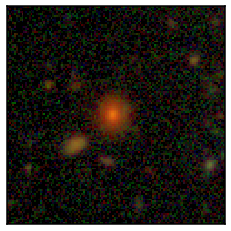

In [232]:
plt.figure(figsize=(4,4))
ax = plt.gca()
ax.imshow(cutout_rgb, origin='upper')
ax.set_xticks([])
ax.set_yticks([])
plt.show()